### **CycleGAN**

**Importing Libraries**

In [18]:
import tensorflow as tf
import tensorflow_datasets as tfds
from google.colab import drive
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from tqdm import tqdm
from IPython import display
import os
import pandas as pd
import glob
import imageio.v2 as imageio

In [ ]:
drive.mount("/content/drive/")

**Dataset**

In [2]:
dataset, info = tfds.load("cycle_gan/horse2zebra", as_supervised=True, with_info=True)
train_horses, train_zebras = dataset["trainA"], dataset["trainB"]
test_horses, test_zebras = dataset["testA"], dataset["testB"]

info

tfds.core.DatasetInfo(
    name='cycle_gan',
    full_name='cycle_gan/horse2zebra/3.0.0',
    description="""
    A dataset consisting of images from two classes A and B (For example: horses/zebras, apple/orange,...)
    """,
    homepage='https://junyanz.github.io/CycleGAN/',
    data_dir='/root/tensorflow_datasets/cycle_gan/horse2zebra/3.0.0',
    file_format=tfrecord,
    download_size=111.45 MiB,
    dataset_size=112.55 MiB,
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=2),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    splits={
        'testA': <SplitInfo num_examples=120, num_shards=1>,
        'testB': <SplitInfo num_examples=140, num_shards=1>,
        'trainA': <SplitInfo num_examples=1067, num_shards=1>,
        'trainB': <SplitInfo num_examples=1334, num_shards=1>,
    },
    citation="""@article{DBLP:journals/corr/ZhuPIE17,
      author 

In [3]:
# Parameters

crop_shape = 286
original_shape = 256
h_channels = 3
z_channels = 3
batch_size = 8
buffer_size = 128
AUTOTUNE = tf.data.AUTOTUNE

lr = 2e-4
beta_1 = 0.5

In [4]:
def preprocess_images(image, label, train=True):
  image = (tf.cast(image, tf.float32) / 127.5) -1

  if train:
    image = tf.image.resize(image, (crop_shape, crop_shape), method="nearest") # resizing to 286 x 286 x 3
    image = tf.image.random_crop(image, (original_shape, original_shape, 3)) # randomly cropping to 256 x 256 x 3
    image = tf.image.random_flip_left_right(image) # randomly flip an image horizontally (left to right)

  return image

In [5]:
train_horses = (train_horses.
                cache().
                map(lambda x, y: preprocess_images(x, y), num_parallel_calls=AUTOTUNE).
                shuffle(buffer_size, seed=123).
                batch(batch_size).
                prefetch(AUTOTUNE))

train_zebras = (train_zebras.
                cache().
                map(lambda x, y: preprocess_images(x, y), num_parallel_calls=AUTOTUNE).
                shuffle(buffer_size, seed=123).
                batch(batch_size).
                prefetch(AUTOTUNE))

train_dataset = tf.data.Dataset.zip((train_horses, train_zebras))


test_horses = (test_horses.
               map(lambda x, y: preprocess_images(x, y, train=False), num_parallel_calls=AUTOTUNE))

test_zebras = (test_zebras.
               map(lambda x, y: preprocess_images(x, y, train=False), num_parallel_calls=AUTOTUNE))

In [6]:
horses, zebras = next(iter(train_dataset))
horses.shape, zebras.shape

(TensorShape([8, 256, 256, 3]), TensorShape([8, 256, 256, 3]))

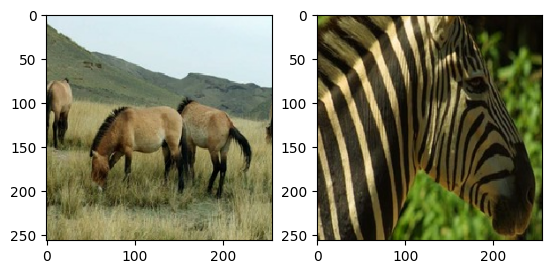

In [7]:
fig, ax = plt.subplots(1, 2)
ax[0].imshow(tf.cast((horses[0] + 1) * 127.5, tf.uint8))
ax[1].imshow(tf.cast((zebras[0] + 1) * 127.5, tf.uint8))
plt.show()

**Models**

In this case both generators and discriminators have the same architecture (h_channels=z_channels)

In [ ]:
# CycleGAN uses a custom layer, Instance normalization, instead of Batch Normalization

@tf.keras.saving.register_keras_serializable()
class InstanceNormalization(tf.keras.layers.Layer):
  def __init__(self, epsilon=1e-5):
    super().__init__()
    self.epsilon = epsilon

  def build(self, input_shape):
    self.scale = self.add_weight(
        name="scale",
        shape=input_shape[-1:],
        initializer=tf.random_normal_initializer(1., 0.02),
        trainable=True)

    self.offset = self.add_weight(
        name="offset",
        shape=input_shape[-1:],
        initializer="zeros",
        trainable=True)

  def call(self, x):
    mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
    inv = tf.math.rsqrt(variance + self.epsilon)
    normalized = (x - mean) * inv
    return self.scale * normalized + self.offset

In [ ]:
# Encoder (downsampler) and Decoder (upsampler)

def downsample(filters, kernel_size, apply_norm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  model = tf.keras.Sequential([
      tf.keras.layers.Conv2D(filters, kernel_size, strides=2, padding="same",
                             kernel_initializer=initializer, use_bias=False)
  ])

  if apply_norm:
    model.add(InstanceNormalization())

  model.add(tf.keras.layers.LeakyReLU(0.3))

  return model


def upsample(filters, kernel_size, use_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  model = tf.keras.Sequential([
      tf.keras.layers.Conv2DTranspose(filters, kernel_size, strides=2, padding="same",
                                      kernel_initializer=initializer, use_bias=False)
  ])

  model.add(InstanceNormalization())

  if use_dropout:
    model.add(tf.keras.layers.Dropout(0.5))

  model.add(tf.keras.layers.ReLU())

  return model

In [ ]:
tf.keras.backend.clear_session()

**``Let x: horses, y: zebras``**

In [ ]:
def Generator(input_channels, output_channels, name):
  input = tf.keras.layers.Input(shape=(original_shape, original_shape, input_channels))

  down_stack = [
    downsample(64, 4, apply_norm=False),
    downsample(128, 4),
    downsample(256, 4),
    downsample(512, 4),
    downsample(512, 4),
    downsample(512, 4),
    downsample(512, 4),
    downsample(512, 4) #bottleneck (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, use_dropout=True),
    upsample(512, 4, use_dropout=True),
    upsample(512, 4, use_dropout=True),
    upsample(512, 4),
    upsample(256, 4),
    upsample(128, 4),
    upsample(64, 4)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last_layer = tf.keras.layers.Conv2DTranspose(output_channels, 4, strides=2, padding="same",
                                               kernel_initializer=initializer, activation="tanh")

  x = input

  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)
  skips = reversed(skips[:-1])

  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate(axis=-1)([x, skip])

  x = last_layer(x)

  return tf.keras.Model(inputs=input, outputs=x, name=name)

In [ ]:
generator_xy = Generator(h_channels, z_channels, name="generator_horses_to_zebras")
generator_yx = Generator(z_channels, h_channels, name="generator_zebras_to_horses")

generator_xy.summary()

Model: "generator_horses_to_zebras"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential (Sequential)     (None, 128, 128, 64)         3072      ['input_1[0][0]']             
                                                                                                  
 sequential_1 (Sequential)   (None, 64, 64, 128)          131328    ['sequential[0][0]']          
                                                                                                  
 sequential_2 (Sequential)   (None, 32, 32, 256)          524800    ['sequential_1[0][0]']        
                                                                         

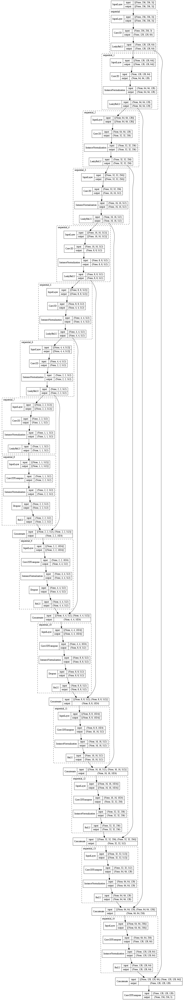

In [ ]:
tf.keras.utils.plot_model(generator_xy, show_shapes=True, show_layer_names=False, expand_nested=True, dpi=70)

In [ ]:
def Discriminator(channels, name):
  initializer = tf.random_normal_initializer(0., 0.02)

  input = tf.keras.layers.Input(shape=(original_shape, original_shape, channels))

  x = downsample(64, 4, apply_norm=False)(input)
  x = downsample(128, 4)(x)
  x = downsample(256, 4)(x)

  x = tf.keras.layers.ZeroPadding2D(padding=1)(x)
  x = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer, use_bias=False)(x)
  x = InstanceNormalization()(x)
  x = tf.keras.layers.LeakyReLU(0.3)(x)

  x = tf.keras.layers.ZeroPadding2D(padding=1)(x)
  x = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(x)

  return tf.keras.Model(inputs=input, outputs=x, name=name)

In [ ]:
discriminator_x = Discriminator(h_channels, name="discriminator_horses")
discriminator_y = Discriminator(z_channels, name="discriminator_zebras")

discriminator_x.summary()

Model: "discriminator_horses"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 sequential_30 (Sequential)  (None, 128, 128, 64)      3072      
                                                                 
 sequential_31 (Sequential)  (None, 64, 64, 128)       131328    
                                                                 
 sequential_32 (Sequential)  (None, 32, 32, 256)       524800    
                                                                 
 zero_padding2d (ZeroPaddin  (None, 34, 34, 256)       0         
 g2D)                                                            
                                                                 
 conv2d_19 (Conv2D)          (None, 31, 31, 512)       2097152   
                                              

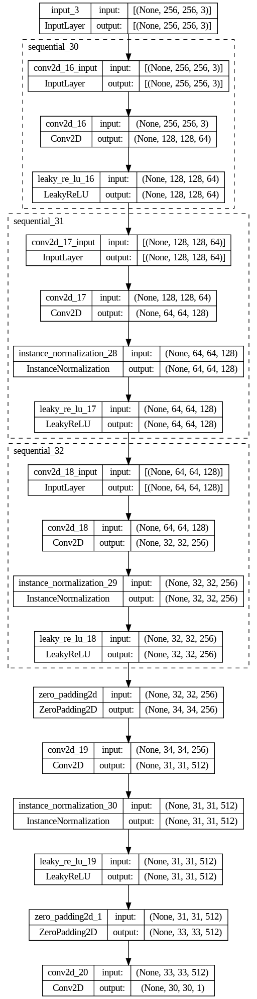

In [ ]:
tf.keras.utils.plot_model(discriminator_x, show_shapes=True, show_layer_names=True, expand_nested=True)

In [ ]:
gen_xy_optimizer = tf.keras.optimizers.Adam(lr, beta_1=beta_1)
gen_yx_optimizer = tf.keras.optimizers.Adam(lr, beta_1=beta_1)
disc_x_optimizer = tf.keras.optimizers.Adam(lr, beta_1=beta_1)
disc_y_optimizer = tf.keras.optimizers.Adam(lr, beta_1=beta_1)

adversarial_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)
identity_loss = tf.keras.losses.MeanAbsoluteError()
cycle_loss = tf.keras.losses.MeanAbsoluteError()

LAMBDA = 10

Because the training is lengthy, it's necessary to use checkpoints.

In [ ]:
# Checkpoints

checkpoint_folder = "/content/drive/MyDrive/checkpoints/TensorFlow_CycleGAN/"
checkpoint_prefix = os.path.join(checkpoint_folder, "ckpt")

checkpoint = tf.train.Checkpoint(generator_xy = generator_xy,
                                 gen_xy_optimizer = gen_xy_optimizer,
                                 generator_yx = generator_yx,
                                 gen_yx_optimizer = gen_yx_optimizer,
                                 discriminator_x = discriminator_x,
                                 disc_x_optimizer = disc_x_optimizer,
                                 discriminator_y = discriminator_y,
                                 disc_y_optimizer = disc_y_optimizer)

pretrained = True #Change according to previous training

if pretrained:
  last_epoch = 80 #Put the last epoch of the pretrained model
  checkpoint.restore(tf.train.latest_checkpoint(checkpoint_folder))

  history = pd.read_csv(os.path.join(checkpoint_folder, f"losses_epoch_{last_epoch}.csv"))
  history = history.to_dict(orient="list")

else:
  last_epoch = 0
  os.makedirs(checkpoint_folder, exist_ok=True)
  history = {"gen_xy_loss":[], "gen_yx_loss":[], "disc_x_loss":[], "disc_y_loss":[]}

In [ ]:
# CycleGAN losses

def get_disc_loss(real_out, fake_out):
  real_loss = adversarial_loss(tf.ones_like(real_out), real_out)
  fake_loss = adversarial_loss(tf.zeros_like(fake_out), fake_out)
  loss = (real_loss + fake_loss) / 2
  return loss

def get_gen_loss(fake_out):
  return adversarial_loss(tf.ones_like(fake_out), fake_out)

def get_cycle_loss(real_images, fake_images):
  loss = cycle_loss(real_images, fake_images)
  return LAMBDA * loss

def get_identity_loss(real_images, fake_images):
  loss = identity_loss(real_images, fake_images)
  return 0.5 * LAMBDA * loss

In [ ]:
@tf.function
def train_step(real_x, real_y):

  with tf.GradientTape(persistent=True) as tape:
    fake_y = generator_xy(real_x, training=True)
    fake_x = generator_yx(real_y, training=True)

    fake_y_cyc = generator_xy(fake_x, training=True)
    fake_x_cyc = generator_yx(fake_y, training=True)

    fake_y_iden = generator_xy(real_y, training=True)
    fake_x_iden = generator_yx(real_x, training=True)

    real_out_x = discriminator_x(real_x, training=True)
    fake_out_x = discriminator_x(fake_x, training=True)

    real_out_y = discriminator_y(real_y, training=True)
    fake_out_y = discriminator_y(fake_y, training=True)

    # Loss of generators
    total_cycle_loss = get_cycle_loss(real_x, fake_x_cyc) + get_cycle_loss(real_y, fake_y_cyc)
    gen_xy_loss = get_gen_loss(fake_out_y) + get_identity_loss(real_y, fake_y_iden) + total_cycle_loss
    gen_yx_loss = get_gen_loss(fake_out_x) + get_identity_loss(real_x, fake_x_iden) + total_cycle_loss

    # Discriminator Loss
    disc_x_loss = get_disc_loss(real_out_x, fake_out_x)
    disc_y_loss = get_disc_loss(real_out_y, fake_out_y)

  # Gradient calculation
  gen_xy_gradients = tape.gradient(gen_xy_loss, generator_xy.trainable_variables)
  gen_yx_gradients = tape.gradient(gen_yx_loss, generator_yx.trainable_variables)
  disc_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
  disc_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

  # Apply the gradients to the optimizer
  gen_xy_optimizer.apply_gradients(zip(gen_xy_gradients, generator_xy.trainable_variables))
  gen_yx_optimizer.apply_gradients(zip(gen_yx_gradients, generator_yx.trainable_variables))
  disc_x_optimizer.apply_gradients(zip(disc_x_gradients, discriminator_x.trainable_variables))
  disc_y_optimizer.apply_gradients(zip(disc_y_gradients, discriminator_y.trainable_variables))

  return gen_xy_loss, gen_yx_loss, disc_x_loss, disc_y_loss

In [8]:
# Function to display images

def show_images(real_x, fake_y, num_examples, random=True, names=["", ""], cmap=None):

  # Denormalization
  real_x = tf.cast((real_x + 1) * 127.5, tf.uint8)
  fake_y = tf.cast((fake_y + 1) * 127.5, tf.uint8)

  indices = np.arange(len(real_x))
  if random:
    np.random.shuffle(indices)

  if num_examples == 1:
    fig, ax = plt.subplots(1, 2, figsize=(8, 4))
    ax[0].imshow(real_x[indices[0]], cmap=cmap)
    ax[0].axis("off")
    ax[0].set_title(names[0], fontsize=10)
    ax[1].imshow(fake_y[indices[0]], cmap=cmap)
    ax[1].axis("off")
    ax[1].set_title(f"Generated {names[1]}", fontsize=10)

  else:
    fig, ax = plt.subplots(num_examples, 2, figsize=(8, 4*num_examples))
    for i in range(num_examples):
      ax[i, 0].imshow(real_x[indices[i]], cmap=cmap)
      ax[i, 0].axis("off")
      ax[i, 1].imshow(fake_y[indices[i]], cmap=cmap)
      ax[i, 1].axis("off")
    ax[0, 0].set_title(names[0], fontsize=10)
    ax[0, 1].set_title(f"Generated {names[1]}", fontsize=10)

  plt.show()

In [ ]:
# Training function

def train_model(epochs, history=history, num_examples=1, save_model=True, display_wait=False):

  for epoch in range(epochs):
    gen_xy_loss_list, gen_yx_loss_list, disc_x_loss_list, disc_y_loss_list = [], [], [], []
    current_epoch = last_epoch + epoch +1

    with tqdm(train_dataset) as pbar:
      pbar.set_description(f"[Epoch: {current_epoch}/{last_epoch + epochs}]")
      for real_x, real_y in pbar:
        gen_xy_loss, gen_yx_loss, disc_x_loss, disc_y_loss = train_step(real_x, real_y)

        gen_xy_loss_list.append(gen_xy_loss.numpy())
        gen_yx_loss_list.append(gen_yx_loss.numpy())
        disc_x_loss_list.append(disc_x_loss.numpy())
        disc_y_loss_list.append(disc_y_loss.numpy())
        pbar.set_postfix({"gen_yx_loss":gen_yx_loss.numpy(),
                          "gen_xy_loss":gen_xy_loss.numpy(),
                          "disc_x_loss":disc_x_loss.numpy(),
                          "disc_y_loss":disc_y_loss.numpy()})

    gen_xy_loss_mean = np.mean(gen_xy_loss_list)
    gen_yx_loss_mean = np.mean(gen_yx_loss_list)
    disc_x_loss_mean = np.mean(disc_x_loss_list)
    disc_y_loss_mean = np.mean(disc_y_loss_list)
    history["gen_xy_loss"].append(gen_xy_loss_mean)
    history["gen_yx_loss"].append(gen_yx_loss_mean)
    history["disc_x_loss"].append(disc_x_loss_mean)
    history["disc_y_loss"].append(disc_y_loss_mean)

    display.clear_output(wait=display_wait)
    print(f"Epoch {current_epoch}, HorseGenLoss: {gen_yx_loss_mean}, ZebraGenLoss: {gen_xy_loss_mean}, "
          f"HorseDiscLoss: {disc_x_loss_mean}, ZebraDiscLoss: {disc_y_loss_mean}")

    fake_y = generator_xy(real_x, training=False)
    fake_x = generator_yx(real_y, training=False)
    show_images(real_x, fake_y, num_examples, names=["Horse", "Zebra"])
    show_images(real_y, fake_x, num_examples, names=["Zebra", "Horse"])

    if save_model and (current_epoch % 10 == 0):
      checkpoint.save(file_prefix=checkpoint_prefix)

      df = pd.DataFrame(history)
      df.to_csv(os.path.join(checkpoint_folder, f"losses_epoch_{current_epoch}.csv"), index=False)

  return history

In [ ]:
epochs = 20

Epoch 100, HorseGenLoss: 2.5024750232696533, ZebraGenLoss: 3.054103136062622, HorseDiscLoss: 0.6070906519889832, ZebraDiscLoss: 0.4320162534713745


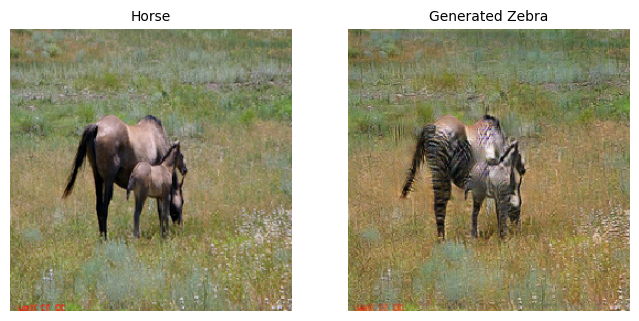

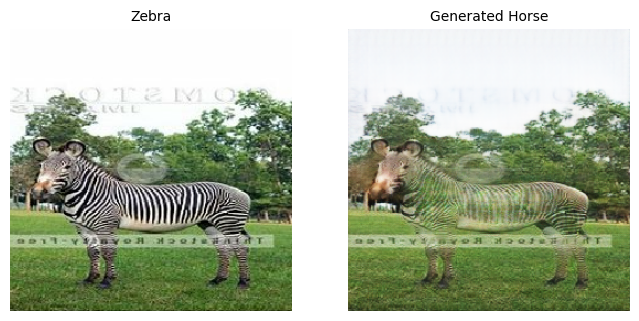

In [ ]:
# Each epoch with the Colab GPU takes approximately 3 min.

tf.random.set_seed(123)
history = train_model(epochs=epochs)

In [ ]:
def plot_metrics(history, renderer=None, epochs = last_epoch + epochs + 1):
  gen_xy_losses = history["gen_xy_loss"]
  gen_yx_losses = history["gen_yx_loss"]
  disc_x_losses = history["disc_x_loss"]
  disc_y_losses = history["disc_y_loss"]
  list_epochs = np.arange(1, epochs+1)

  fig=go.Figure()
  fig.add_trace(go.Scatter(x=list_epochs, y=gen_yx_losses, name="HorseGenLoss", line=dict(color="skyblue", width=2)))
  fig.add_trace(go.Scatter(x=list_epochs, y=gen_xy_losses, name="ZebraGenLoss", line=dict(color="blue", width=2)))
  fig.add_trace(go.Scatter(x=list_epochs, y=disc_x_losses, name="HorseDiscLoss", line=dict(color="red", width=2)))
  fig.add_trace(go.Scatter(x=list_epochs, y=disc_y_losses, name="ZebraDiscLoss", line=dict(color="#FF6600", width=2)))
  fig.update_xaxes(title_text="Epoch")
  fig.update_yaxes(title_text="Loss")
  fig.update_layout(title=f"<b>Evolution of Loss across Epochs</b>",
                    title_font=dict(size=20),
                    title_x=0.5,
                    height=500,
                    width=1200)
  fig.show(renderer)

In [ ]:
# Interactive graphic
plot_metrics(history)

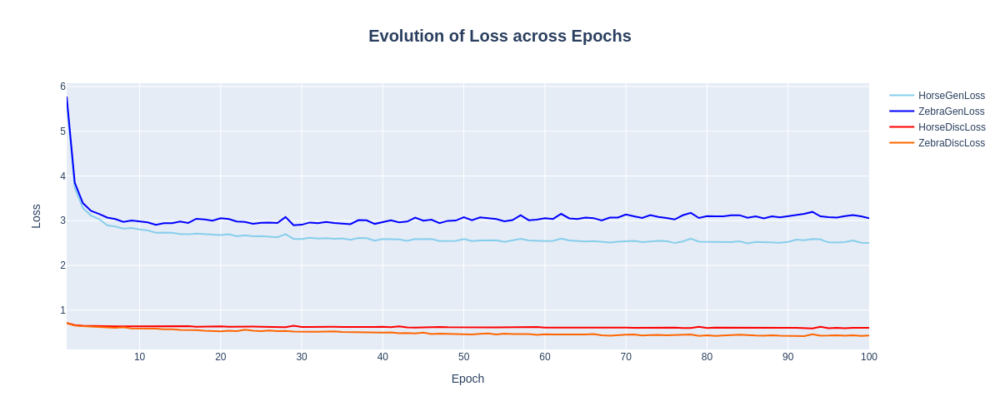

In [ ]:
# Image for GitHub
plot_metrics(history, renderer="png")

In [ ]:
# Save only the generators
generator_xy.save("/content/drive/MyDrive/models/generator_horse_to_zebra.keras")
generator_yx.save("/content/drive/MyDrive/models/generator_zebra_to_horse.keras")

**Examples with the training dataset**

In [9]:
tf.keras.backend.clear_session()

In [10]:
# Custom Layer

@tf.keras.saving.register_keras_serializable()
class InstanceNormalization(tf.keras.layers.Layer):
  def __init__(self, epsilon=1e-5):
    super().__init__()
    self.epsilon = epsilon

  def build(self, input_shape):
    self.scale = self.add_weight(
        name="scale",
        shape=input_shape[-1:],
        initializer=tf.random_normal_initializer(1., 0.02),
        trainable=True)

    self.offset = self.add_weight(
        name="offset",
        shape=input_shape[-1:],
        initializer="zeros",
        trainable=True)

  def call(self, x):
    mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
    inv = tf.math.rsqrt(variance + self.epsilon)
    normalized = (x - mean) * inv
    return self.scale * normalized + self.offset

In [11]:
# Load generators
generator_xy = tf.keras.models.load_model("/content/drive/MyDrive/models/generator_horse_to_zebra.keras")
generator_yx = tf.keras.models.load_model("/content/drive/MyDrive/models/generator_zebra_to_horse.keras")

generator_xy.summary()

Model: "generator_horses_to_zebras"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential (Sequential)     (None, 128, 128, 64)         3072      ['input_1[0][0]']             
                                                                                                  
 sequential_1 (Sequential)   (None, 64, 64, 128)          131328    ['sequential[0][0]']          
                                                                                                  
 sequential_2 (Sequential)   (None, 32, 32, 256)          524800    ['sequential_1[0][0]']        
                                                                         

In [12]:
train_horses = train_horses.unbatch().as_numpy_iterator()
train_horses = np.array(list(train_horses))

train_zebras = train_zebras.unbatch().as_numpy_iterator()
train_zebras = np.array(list(train_zebras))

train_horses.shape, train_zebras.shape

((1067, 256, 256, 3), (1334, 256, 256, 3))

In [13]:
fake_zebras_train = generator_xy.predict(train_horses, batch_size=batch_size)
fake_horses_train = generator_yx.predict(train_zebras, batch_size=batch_size)

167/167 [==============================] - 11s 63ms/step


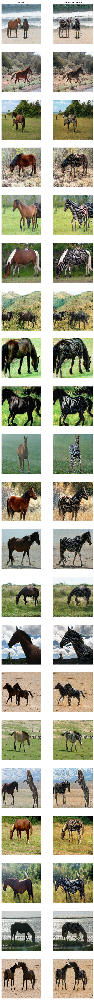

In [14]:
list_indices = [18, 117, 153, 203, 215, 241, 246, 295, 310, 323, 339,
                360, 363, 426, 446, 544, 750, 860, 918, 1022, 1031]

show_images(train_horses[list_indices], fake_zebras_train[list_indices],
            num_examples=len(list_indices), random=False, names=["Horse", "Zebra"])

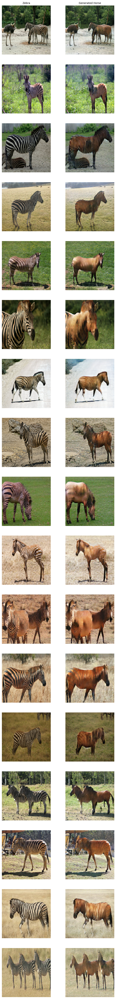

In [15]:
list_indices = [121, 192, 193, 200, 243, 245, 366, 382, 396, 430, 619, 725, 731, 844, 1000, 1007, 1011]

show_images(train_zebras[list_indices], fake_horses_train[list_indices],
            num_examples=len(list_indices), random=False, names=["Zebra", "Horse"])

**Examples with the testing dataset**

In [16]:
test_horses = test_horses.as_numpy_iterator()
test_horses = np.array(list(test_horses))

test_zebras = test_zebras.as_numpy_iterator()
test_zebras = np.array(list(test_zebras))

test_horses.shape, test_zebras.shape

((120, 256, 256, 3), (140, 256, 256, 3))

In [17]:
fake_zebras_test = generator_xy.predict(test_horses, batch_size=batch_size)
fake_horses_test = generator_yx.predict(test_zebras, batch_size=batch_size)

18/18 [==============================] - 3s 160ms/step


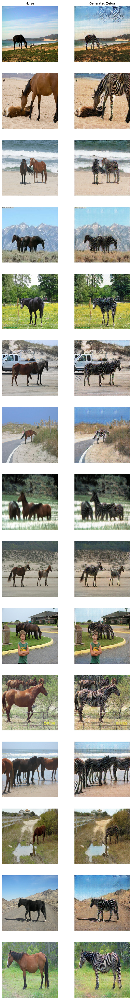

In [18]:
list_indices = [4, 20, 32, 38, 48, 49, 52, 62, 65, 67, 78, 85, 86, 91, 92]
show_images(test_horses[list_indices], fake_zebras_test[list_indices],
            num_examples=len(list_indices), random=False, names=["Horse", "Zebra"])

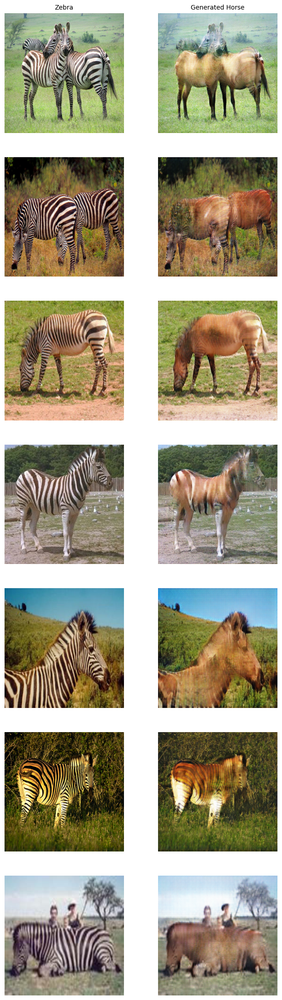

In [19]:
list_indices = [12, 36, 52, 107, 115, 122, 130]
show_images(test_zebras[list_indices], fake_horses_test[list_indices],
            num_examples=len(list_indices), random=False, names=["Zebra", "Horse"])

**Save the sample images and create a GIF with them**

In [20]:
!pip install tensorflow_docs -q

import tensorflow_docs.vis.embed as embed

In [21]:
# Function to display images

def show_exemplary_images(real_x, fake_y, fake_x_cyc, image_path, names=["", ""]):

  # Denormalization
  real_x = tf.cast((real_x + 1) * 127.5, tf.uint8)
  fake_y = tf.cast((fake_y + 1) * 127.5, tf.uint8)
  fake_x_cyc = tf.cast((fake_x_cyc + 1) * 127.5, tf.uint8)

  fig, ax = plt.subplots(1, 3, figsize=(12, 5))
  ax[0].imshow(real_x)
  ax[0].axis("off")
  ax[0].set_title(names[0], fontsize=10)
  ax[1].imshow(fake_y)
  ax[1].axis("off")
  ax[1].set_title(f"Generated {names[1]}", fontsize=10)
  ax[2].imshow(fake_x_cyc)
  ax[2].axis("off")
  ax[2].set_title(f"Cycled {names[0]}", fontsize=10)

  # Save images
  plt.savefig(image_path)

  plt.show()

In [67]:
# Function to create gifs

def create_gif(gif_file, images_file):
  with imageio.get_writer(gif_file, mode="I", loop=0, fps=1) as writer:
    filenames = sorted(glob.glob(f"{images_file}/*.png"))
    for filename in filenames:
      image = imageio.imread(filename)
      writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

In [45]:
# Image directories
directory_images = "/content/drive/MyDrive/images"
directory_horses_to_zebras = os.path.join(directory_images, "horses_to_zebras")
directory_zebras_to_horses = os.path.join(directory_images, "zebras_to_horses")

os.makedirs(directory_horses_to_zebras, exist_ok=True)
os.makedirs(directory_zebras_to_horses, exist_ok=True)

In [ ]:
# Horses to Zebras

list_indices_test = [49, 67, 78, 92]
list_indices_train = [215, 241, 446, 544, 750, 918]

for i, ind in enumerate(list_indices_test[::-1]):
  fake_horse_cyc = generator_yx.predict(fake_zebras_test[ind][None, :], verbose=0)[0]
  show_exemplary_images(test_horses[ind],
                        fake_zebras_test[ind],
                        fake_horse_cyc,
                        os.path.join(directory_horses_to_zebras, f"image{i:02d}.png"),
                        ["Horse", "Zebra"])
  display.clear_output(wait=True)

for i, ind in enumerate(list_indices_train, len(list_indices_test)):
  fake_horse_cyc = generator_yx.predict(fake_zebras_train[ind][None, :], verbose=0)[0]
  show_exemplary_images(train_horses[ind],
                        fake_zebras_train[ind],
                        fake_horse_cyc,
                        os.path.join(directory_horses_to_zebras, f"image{i:02d}.png"),
                        ["Horse", "Zebra"])
  display.clear_output(wait=True)

In [46]:
gif_file_xy = os.path.join(directory_images, "horses_to_zebras.gif")


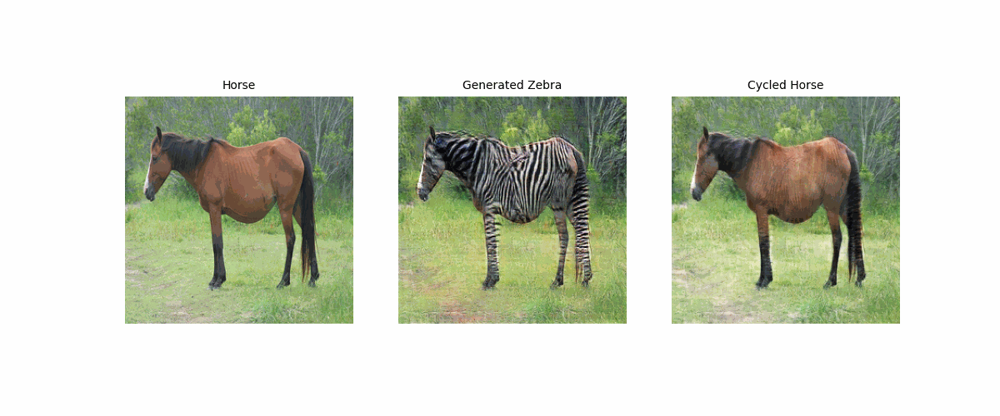

In [68]:
create_gif(gif_file_xy, directory_horses_to_zebras)
embed.embed_file(gif_file_xy)

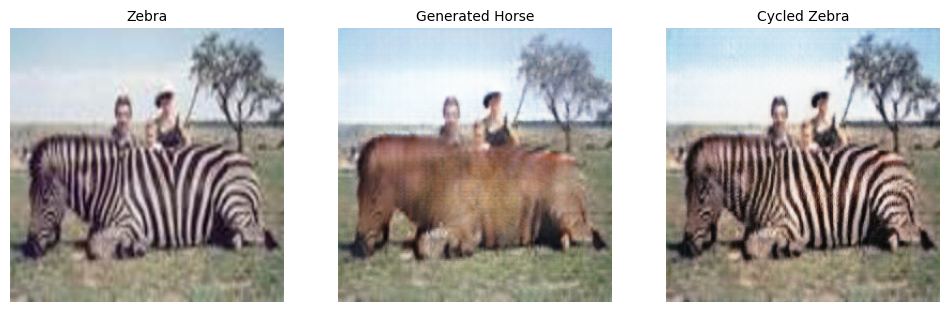

In [48]:
# Zebras to Horses

list_indices_train = [243, 366, 396, 430, 619, 725, 731, 844]
list_indices_test = [52, 130]

for i, ind in enumerate(list_indices_train):
  fake_zebra_cyc = generator_xy.predict(fake_horses_train[ind][None, :], verbose=0)[0]
  show_exemplary_images(train_zebras[ind],
                        fake_horses_train[ind],
                        fake_zebra_cyc,
                        os.path.join(directory_zebras_to_horses, f"image{i:02d}.png"),
                        ["Zebra", "Horse"])
  display.clear_output(wait=True)

for i, ind in enumerate(list_indices_test, len(list_indices_train)):
  fake_zebra_cyc = generator_xy.predict(fake_horses_test[ind][None, :], verbose=0)[0]
  show_exemplary_images(test_zebras[ind],
                        fake_horses_test[ind],
                        fake_zebra_cyc,
                        os.path.join(directory_zebras_to_horses, f"image{i:02d}.png"),
                        ["Zebra", "Horse"])
  display.clear_output(wait=True)

In [60]:
gif_file_yx = os.path.join(directory_images, "zebras_to_horses.gif")


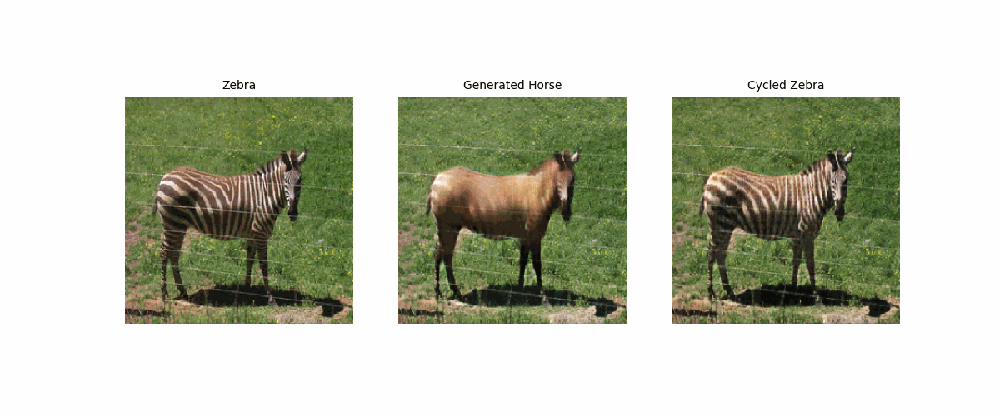

In [69]:
create_gif(gif_file_yx, directory_zebras_to_horses)
embed.embed_file(gif_file_yx)